# Import libraries we need and set some parameters

In [1]:
import sys
import seaborn as sb
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
import statsmodels.formula.api as smf
import argparse
import gc
import math
##import diffxpy.api as de
##import scvelo as scv
%matplotlib inline

In [2]:
%matplotlib inline

##################
# Configure file #
##################
sc.settings.verbosity = 2
sc.settings.autoshow = False

##logging.basicConfig(filename="CLUESImmVar_processed.V4.1.log", level=logging.ERROR)
sc.settings.set_figure_params(dpi=100, dpi_save=600, format='png')

plt.rcParams["image.aspect"] = "equal"
##%matplotlib inline

In [3]:
version = "V6.1"

figdir = "./figures."+version+"/"
sc.settings.figdir = figdir

# Read in the data

In [4]:
adata = sc.read("../h5ad/CLUESImmVarLymphoid_annotated."+version+".h5ad", cache=False)
adata.shape

Only considering the two last: ['.1', '.h5ad'].
Only considering the two last: ['.1', '.h5ad'].


(524784, 1521)

## Figure 4A: Annotate leiden clusters and plot

In [5]:
pd.set_option('display.max_columns', None)
unique_leiden = np.unique(adata.obs['leiden'].values)
# Compile list of top genes
GeneRanks = pd.DataFrame()
for ii in range(len(unique_leiden)):
    GeneRanks[str('leiden_' + str(ii))] = adata.var_names[np.flipud(np.argsort(np.mean(adata.X[adata.obs['leiden'] == str(ii)], axis=0)))]
##GeneRanks.to_csv('FLARE_top_expression.csv')
GeneRanks.head(20)

,leiden_0,leiden_1,leiden_2,leiden_3,leiden_4,leiden_5,leiden_6,leiden_7,leiden_8,leiden_9,leiden_10,leiden_11,leiden_12,leiden_13,leiden_14,leiden_15,leiden_16,leiden_17,leiden_18,leiden_19,leiden_20,leiden_21
0,TSHZ2,CD79A,S100A4,GZMH,RP11-291B21.2,GZMB,RP5-887A10.1,GZMK,PPBP,SBF2,RTKN2,SLC4A10,XCL1,IFIT3,SOX4,HBA1,KIAA0101,EIF1AY,ACVR2B,HLA-DRA,TNFRSF17,ACVR2B
1,LTB,HLA-DRA,TNFRSF4,CCL5,CD8B,KLRF1,MS4A1,DUSP2,CLU,CTD-2035E11.3,RP11-1399P15.1,KLRB1,XCL2,IFI44L,CHI3L2,HBA2,TYMS,RPS4Y1,PRDM6,CD79A,MZB1,PRDM6
2,AIF1,TCL1A,ITGB1,NKG7,S100B,PRF1,HLA-DRA,CCL5,MYL9,IL32,IL2RA,GZMK,KLRC1,IFI6,ITM2A,FGFBP2,MKI67,DDX3Y,GABRE,CD74,IGJ,MS4A1
3,FAM13A,CD74,LTB,CST7,CD8A,SPON2,CD79A,LYAR,NRGN,CD8B,ICA1,KLRG1,CMC1,ISG15,AIF1,GZMB,STMN1,PRDM6,HBB,HLA-DQB1,DERL3,HLA-DQB1
4,EPHB6,CD79B,ANXA1,FGFBP2,AIF1,GNLY,BANK1,PIK3R1,TREML1,ZFP36L2,TIGIT,NCR3,GNLY,IFIT1,MIR181A1HG,NKG7,TK1,DONSON,DONSON,TCL1A,HRASLS2,HLA-DRA
5,TMIGD2,HLA-DQB1,IL32,GZMA,PASK,TYROBP,AL928768.3,CD8B,GP9,JUN,ARID5B,DUSP2,SPTSSB,MX1,LTB,PRF1,NUSAP1,TTTY15,IFI27,HLA-DPA1,ITM2C,BANK1
6,AC013264.2,HLA-DRB1,RP11-403A21.2,S100A4,CRTAM,FCER1G,CLECL1,CMC1,LTB,CD8A,IKZF2,LYAR,KLRF1,USP18,EPHB6,CST7,PCNA,UTY,PPBP,HLA-DPB1,AL928768.3,CD79A
7,HSPB1,MEF2C,S100A11,IL32,SPINK2,CLIC3,CD74,IL32,AIF1,TNFAIP3,DUSP4,AC092580.4,TYROBP,RSAD2,TMIGD2,SPON2,CLSPN,GABRE,PF4,HLA-DRB1,IGLL5,CD79B
8,SCGB3A1,MS4A1,TIMP1,CCL4,PRDM6,FGFBP2,HLA-DPA1,CD8A,PF4,HCST,FOXP3,CCL5,IL2RB,EIF2AK2,STMN1,GNLY,BIRC5,ACVR2B,CCL5,NKG7,CD38,HLA-DPA1
9,ITM2A,HLA-DPA1,GATA3,GNLY,DONSON,FCGR3A,HLA-DQA1,ZFP36L2,CD7,RP5-1073O3.7,IL32,GZMA,NCAM1,HERC5,HSPB1,GZMA,CENPF,LTB,NKG7,MS4A1,POU2AF1,CD74


In [6]:
adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('str')

## do some manual cell type assignment
adata.obs.loc[adata.obs.leiden == "0","ct_cov"] = "T4naive" # 
adata.obs.loc[adata.obs.leiden == "1","ct_cov"] = "Bnaive" # TCL1A downregulated in memory B
adata.obs.loc[adata.obs.leiden == "2","ct_cov"] = "T4cm" # CXCR3 positive
adata.obs.loc[adata.obs.leiden == "3","ct_cov"] = "T8em cyto1" # CXCR3+, CCR7-, GZMH+
adata.obs.loc[adata.obs.leiden == "4","ct_cov"] = "T8naive" # 
adata.obs.loc[adata.obs.leiden == "5","ct_cov"] = "NK CD56dim"# CD56dim, FCGR3A+, no CD3
adata.obs.loc[adata.obs.leiden == "6","ct_cov"] = "Bmem" # CXCR3
adata.obs.loc[adata.obs.leiden == "7","ct_cov"] = "T8em cyto2"# CXCR3+, CCR7+, GZMK+
adata.obs.loc[adata.obs.leiden == "8","ct_cov"] = "MKcontam" # 
adata.obs.loc[adata.obs.leiden == "9","ct_cov"] = "T8cm" # 
adata.obs.loc[adata.obs.leiden == "10","ct_cov"] = "T4reg" # CD27 late stage, CXCR3-, CCR7+, CD62L
adata.obs.loc[adata.obs.leiden == "11","ct_cov"] = "T8em MAIT" # CXCR3-, CCR7-, KLRB1+, should express TRAV1-2 TRVJ33
adata.obs.loc[adata.obs.leiden == "12","ct_cov"] = "NK CD56bright" # CD56bright, FCGR3A-, no CD3
adata.obs.loc[adata.obs.leiden == "13","ct_cov"] = "T4IFN" # 
adata.obs.loc[adata.obs.leiden == "14","ct_cov"] = "Progenitor" # 
adata.obs.loc[adata.obs.leiden == "15","ct_cov"] = "NKT" # CD56DIM, FCGR3A-, CD3 ?
adata.obs.loc[adata.obs.leiden == "16","ct_cov"] = "TProlif" #
adata.obs.loc[adata.obs.leiden == "17","ct_cov"] = "T4naive" #
adata.obs.loc[adata.obs.leiden == "18","ct_cov"] = "T8cm" # CD27 late stage, CXCR3-, CCR7+, CD62L
adata.obs.loc[adata.obs.leiden == "19","ct_cov"] = "Batypical" #
adata.obs.loc[adata.obs.leiden == "20","ct_cov"] = "Bplasma" #
adata.obs.loc[adata.obs.leiden == "21","ct_cov"] = "Bmem" #

adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('category')

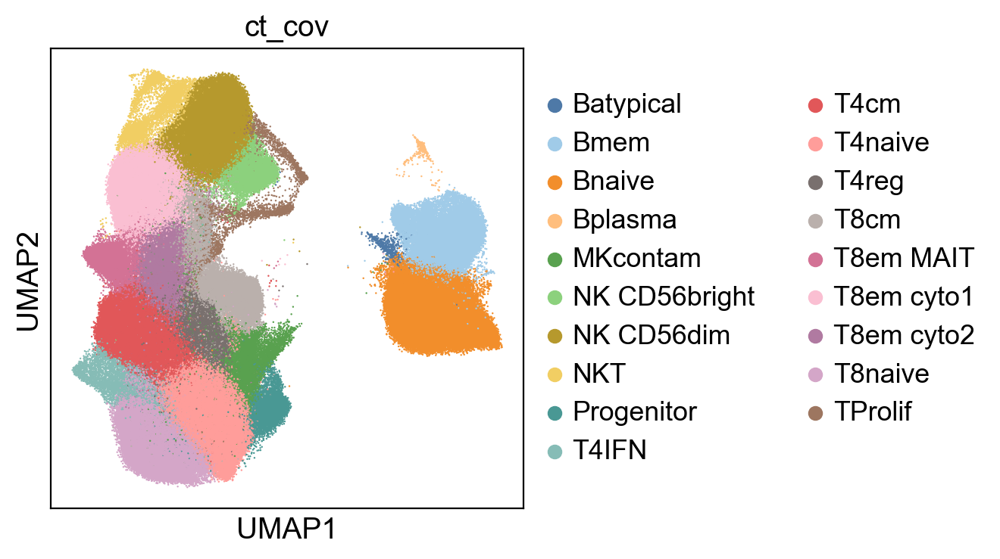

In [7]:
#plot UMAP of cell types colored by clusters
sc.pl.palettes.vega_20_scanpy;
adata.uns['ct_cov_colors'] = sc.pl.palettes.vega_20_scanpy;
adata.uns['ct_cov_colors'] = ["#4E79A7","#A0CBE8","#F28E2B","#FFBE7D","#59A14F","#8CD17D","#B6992D","#F1CE63","#499894","#86BCB6","#E15759","#FF9D9A","#79706E","#BAB0AC","#D37295","#FABFD2","#B07AA1","#D4A6C8","#9D7660","#D7B5A6"]
sc.pl.umap(adata, color='ct_cov', size = 3)
sc.pl.umap(adata, color='ct_cov', size=2, edgecolor="none", save="_ct_cov.png")

In [8]:
adata.obs.to_csv('adata_obs_lymphoid.'+version+'.txt')

## Make a pseudobulk expression matrix that's useful for comparisons

In [9]:
def marker_gene_expression(anndata, marker_dict, gene_symbol_key=None, partition_key='louvain_r1'):
    """A function go get mean z-score expressions of marker genes
    # 
    # Inputs:
    #    anndata         - An AnnData object containing the data set and a partition
    #    marker_dict     - A dictionary with cell-type markers. The markers should be stores as anndata.var_names or 
    #                      an anndata.var field with the key given by the gene_symbol_key input
    #    gene_symbol_key - The key for the anndata.var field with gene IDs or names that correspond to the marker 
    #                      genes
    #    partition_key   - The key for the anndata.obs field where the cluster IDs are stored. The default is
    #                      'louvain_r1' """

    #Test inputs
    if partition_key not in anndata.obs.columns.values:
        print('KeyError: The partition key was not found in the passed AnnData object.')
        print('   Have you done the clustering? If so, please tell pass the cluster IDs with the AnnData object!')
        raise

    if (gene_symbol_key != None) and (gene_symbol_key not in anndata.var.columns.values):
        print('KeyError: The provided gene symbol key was not found in the passed AnnData object.')
        print('   Check that your cell type markers are given in a format that your anndata object knows!')
        raise
        

    if gene_symbol_key:
        gene_ids = anndata.var[gene_symbol_key]
    else:
        gene_ids = anndata.var_names

    clusters = anndata.obs[partition_key].cat.categories
    n_clust = len(clusters)
    marker_exp = pd.DataFrame(columns=clusters)
    marker_exp['cell_type'] = pd.Series({}, dtype='str')
    marker_names = []
    
    z_scores = sc.pp.scale(anndata, copy=True)

    i = 0
    for group in marker_dict:
        # Find the corresponding columns and get their mean expression in the cluster
        for gene in marker_dict[group]:
            ens_idx = np.in1d(gene_ids, gene) #Note there may be multiple mappings
            if np.sum(ens_idx) == 0:
                continue
            else:
                z_scores.obs[ens_idx[0]] = z_scores.X[:,ens_idx].mean(1) #works for both single and multiple mapping
                ens_idx = ens_idx[0]

            clust_marker_exp = z_scores.obs.groupby(partition_key)[ens_idx].apply(np.mean).tolist()
            clust_marker_exp.append(group)
            marker_exp.loc[i] = clust_marker_exp
            marker_names.append(gene)
            i+=1

    #Replace the rownames with informative gene symbols
    marker_exp.index = marker_names

    return(marker_exp)

In [10]:
marker_dictionary = pd.DataFrame({"all": adata.var_names})

rst = marker_gene_expression(adata, marker_dictionary, partition_key="ct_cov")

In [11]:
rst.to_csv("lymphoid_expr_ct_cov.csv")

# Figure 4B: Ranked genes and stacked violin plot of the markers

ranking genes
    finished (0:03:05)


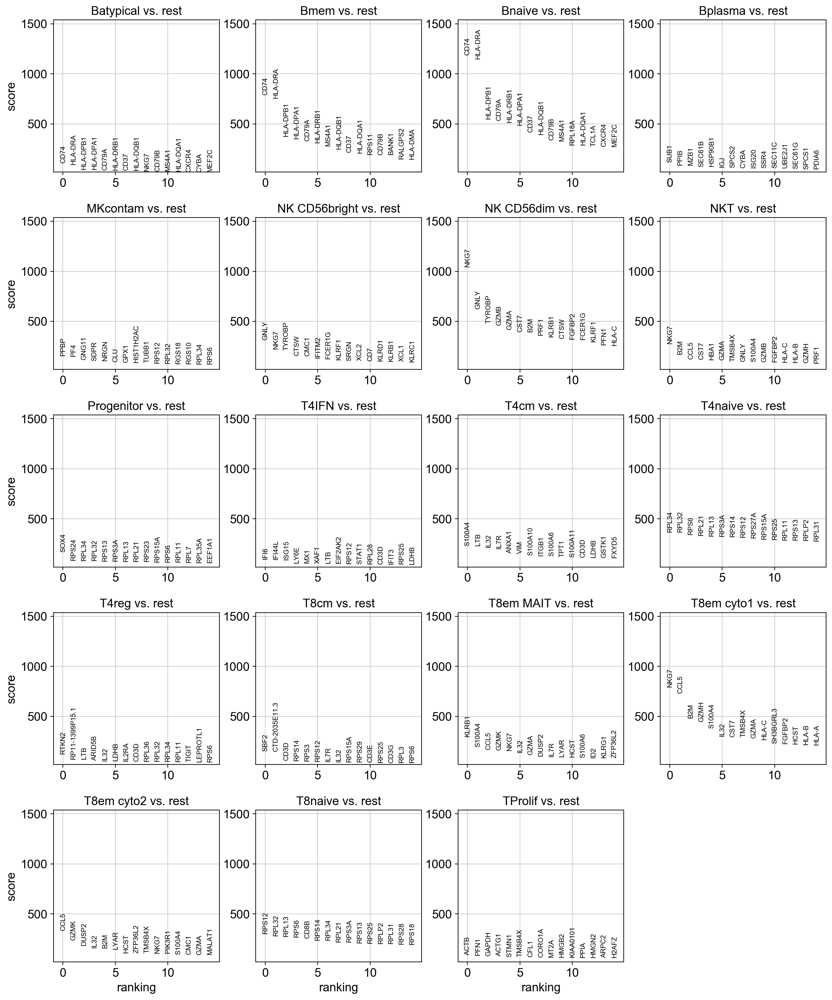

In [12]:
sc.tl.rank_genes_groups(adata,groupby='ct_cov',method='t-test',n_genes=15)
sc.pl.rank_genes_groups(adata)

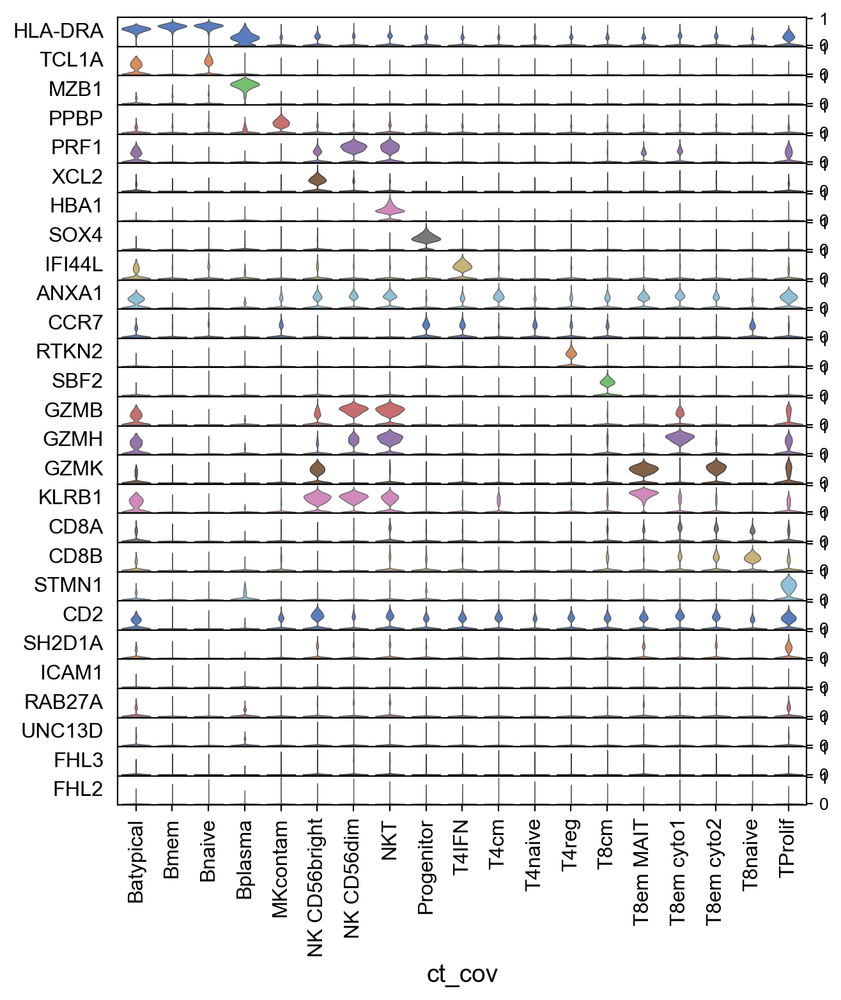

In [13]:
##['CD4','CD8B','NKG7','GZMK','GZMB','CCR7','LTB','CCL5', 'IFI6', 'CD79A','MZB1','FOXP3','XCL1','SOX4','PF4']
## 'TNFRSF4','TSHZ2','ANXA1', 'AIF1', 'S100A4','TIMP1','GATA3' don't look very good
sc.pl.stacked_violin(adata, var_names=['HLA-DRA','TCL1A','MZB1','PPBP', 'PRF1', 'XCL2', 'HBA1', 'SOX4', 'IFI44L', 'ANXA1', 'CCR7', 'RTKN2', 'SBF2', 'GZMB','GZMH','GZMK','KLRB1', 'CD8A', 'CD8B', 'STMN1', 'CD2', 'SH2D1A', 'ICAM1', 'RAB27A', 'UNC13D', 'FHL3', 'FHL2'], groupby="ct_cov", swap_axes=True, standard_scale="var")
sc.pl.stacked_violin(adata, var_names=['HLA-DRA','TCL1A','MZB1','PPBP', 'PRF1', 'XCL2', 'HBA1', 'SOX4', 'IFI44L', 'ANXA1', 'CCR7', 'RTKN2', 'SBF2', 'GZMB','GZMH','GZMK','KLRB1', 'CD8B', 'STMN1'], groupby="ct_cov", save=".png", swap_axes=True, standard_scale="var")

## Make some feature plots to justify annotation

### KIR sequences for unique NKs

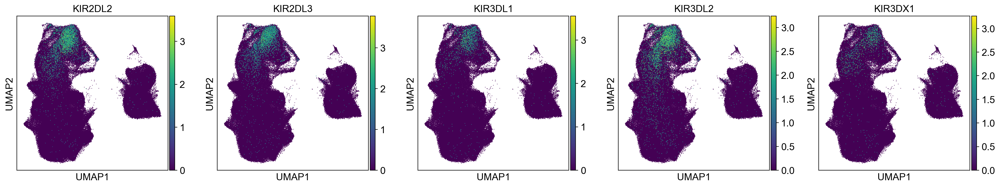

In [14]:
sc.pl.umap(adata, color=['KIR2DL2', 'KIR2DL3', 'KIR3DL1', 'KIR3DL2', 'KIR3DX1'], palette="Greys", size=3, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

### Look at Tph cell signature

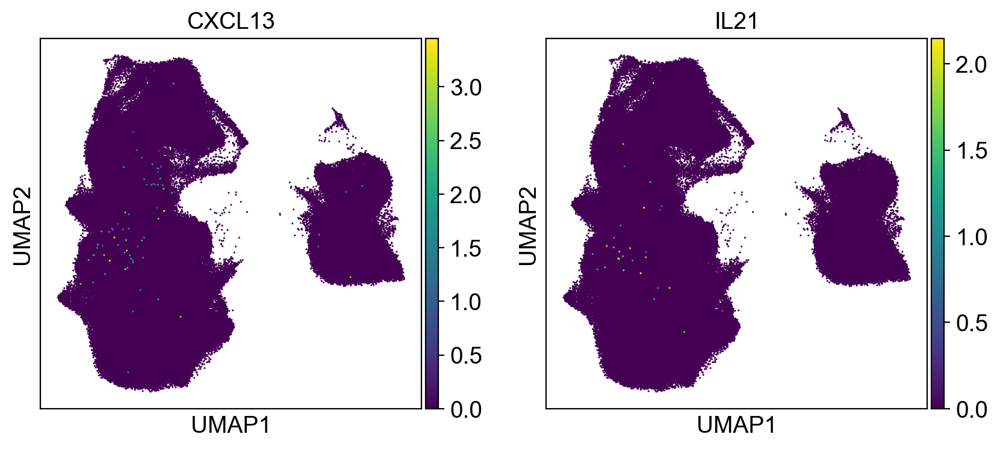

In [15]:
sc.pl.umap(adata, color=['CXCL13', 'IL21'], palette="Greys", size=5, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

### NK signature

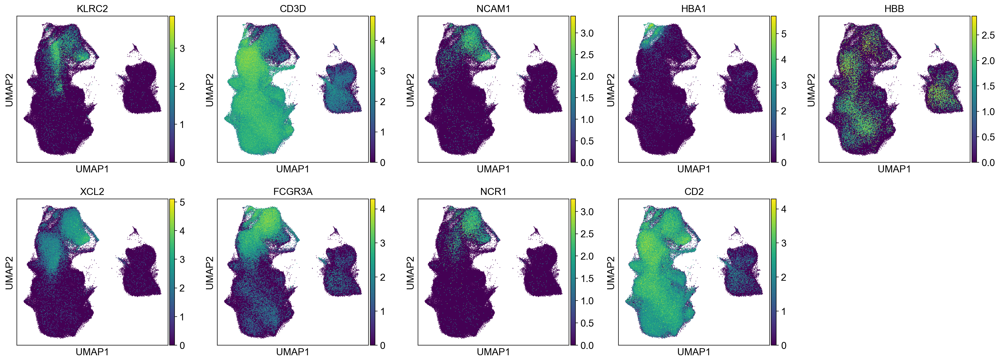

In [16]:
sc.pl.umap(adata, color=['KLRC2', 'CD3D', 'NCAM1', 'HBA1', 'HBB', 'XCL2', 'FCGR3A', 'NCR1','CD2'], palette="Greys", size=3, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

### CD8 signature

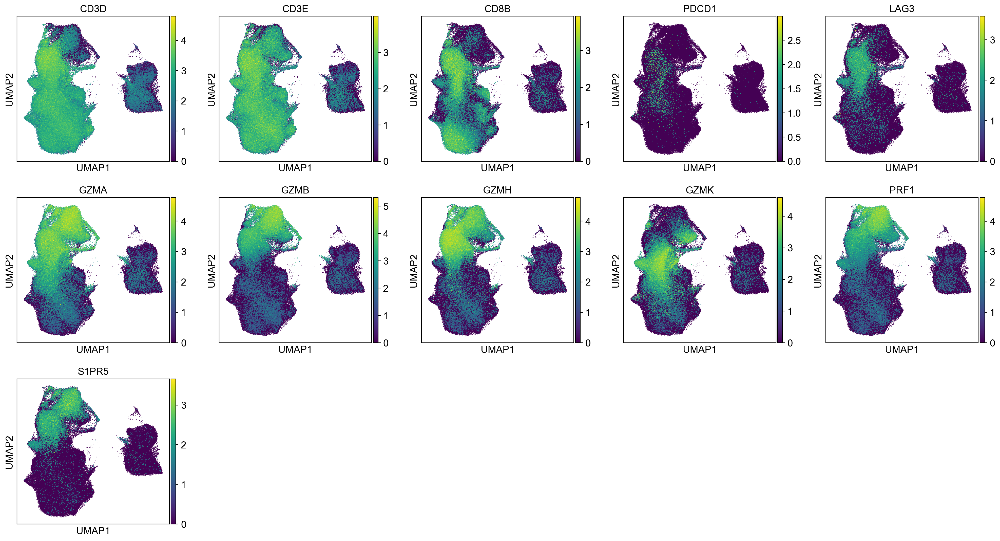

In [17]:
sc.pl.umap(adata, color=['CD3D', 'CD3E', 'CD8B','PDCD1', 'LAG3', 'GZMA', 'GZMB', 'GZMH', 'GZMK', 'PRF1', 'S1PR5'], palette="Greys", size=3, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

### Treg signature

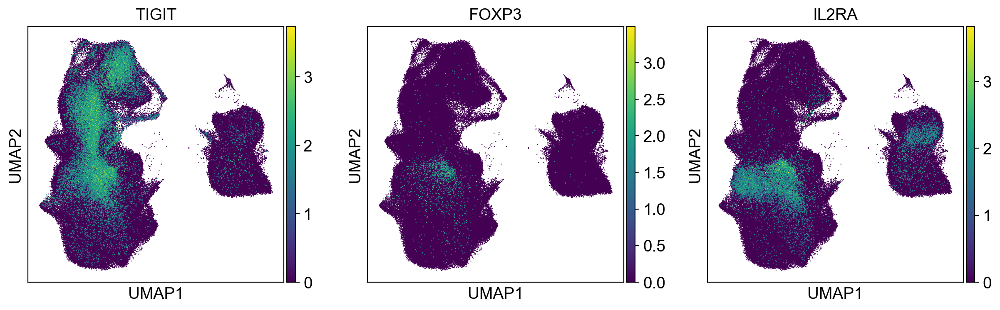

In [18]:
sc.pl.umap(adata, color=['TIGIT', 'FOXP3', 'IL2RA'], palette="Greys", size=3, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

### CD4 signature

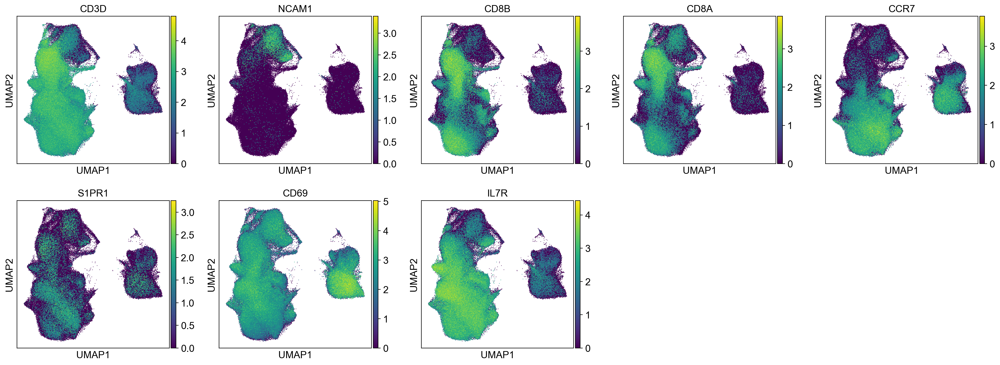

In [19]:
sc.pl.umap(adata, color=['CD3D', 'NCAM1','CD8B','CD8A','CCR7','S1PR1','CD69', 'IL7R'], palette="Greys", size=3, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

### B cell signature

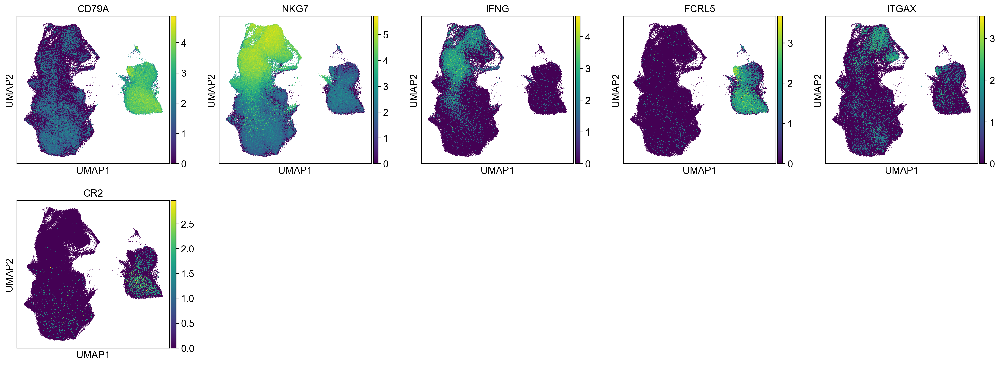

In [20]:
sc.pl.umap(adata, color=['CD79A', 'NKG7', 'IFNG', 'FCRL5','ITGAX','CR2'], palette="Greys", size=3, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

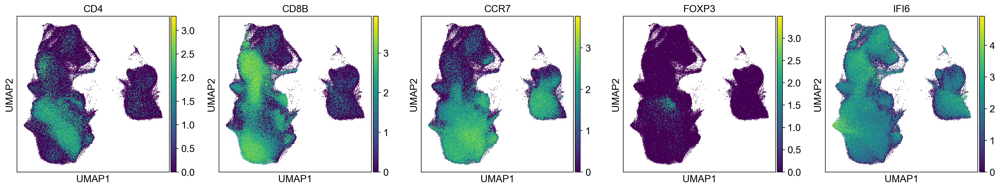

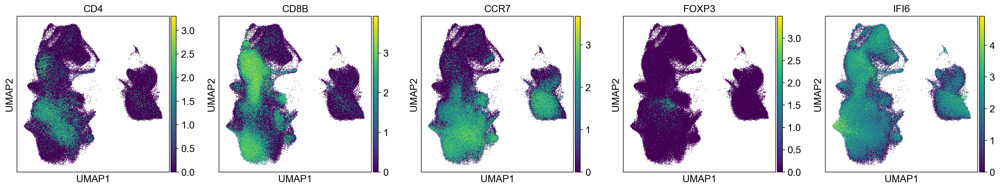

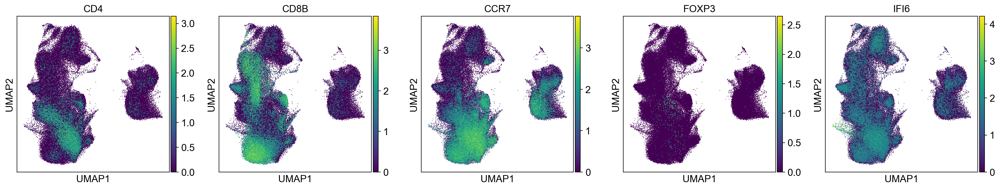

In [21]:
# sc.pl.umap(adata, color=['CD4', 'CD8B','CCR7', "FOXP3","IFI6"], palette="Greys", size=3, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
# sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['CD4', 'CD8B','CCR7', "FOXP3","IFI6"], palette="Greys", size=3, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
# sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['CD4', 'CD8B','CCR7', "FOXP3","IFI6"], palette="Greys", size=3,ncols=5) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

# sc.pl.umap(adata, color=['CD4', 'CD8B','CCR7', "FOXP3","IFI6"], palette="Greys", size=3, ncols=5,save=".markers.all.png") ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
# sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['CD4', 'CD8B','CCR7', "FOXP3","IFI6"], palette="Greys", size=3, ncols=5, save=".markers.sle.png") ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
# sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['CD4', 'CD8B','CCR7', "FOXP3","IFI6"], palette="Greys", size=3,ncols=5, save=".markers.healthy.png") ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)



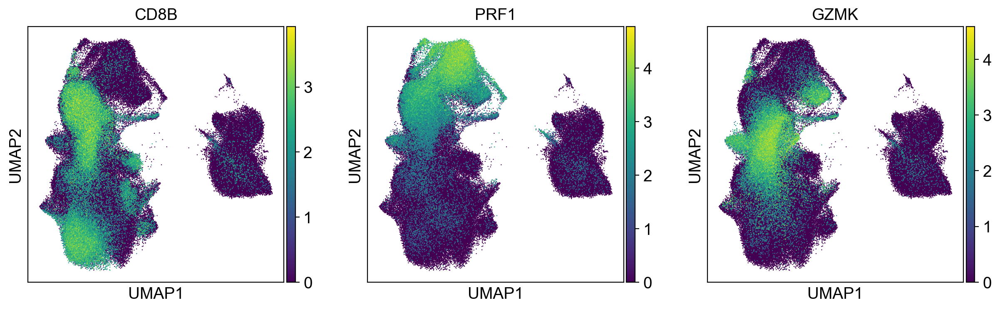

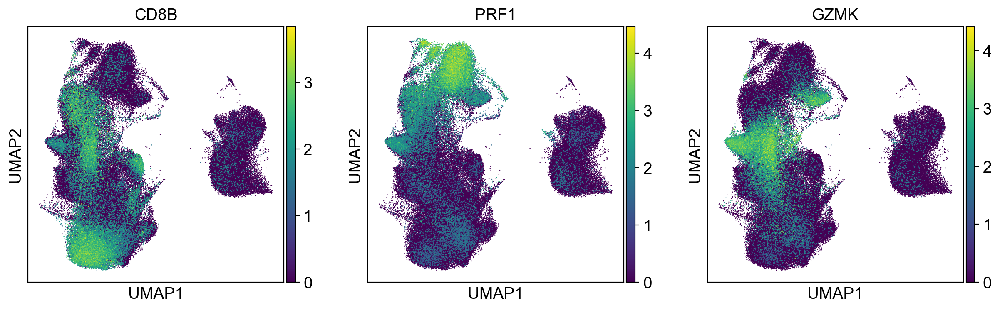

In [22]:
# sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['CD8B',"PRF1","GZMK"], palette="Greys", size=3) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
# sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['CD8B',"PRF1","GZMK"], palette="Greys", size=3) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)



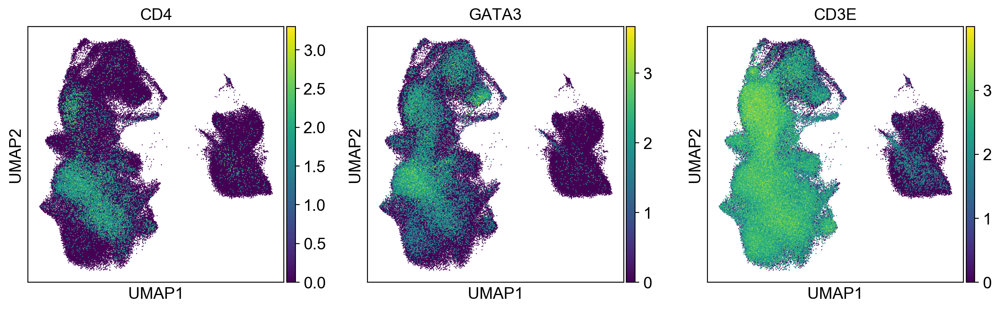

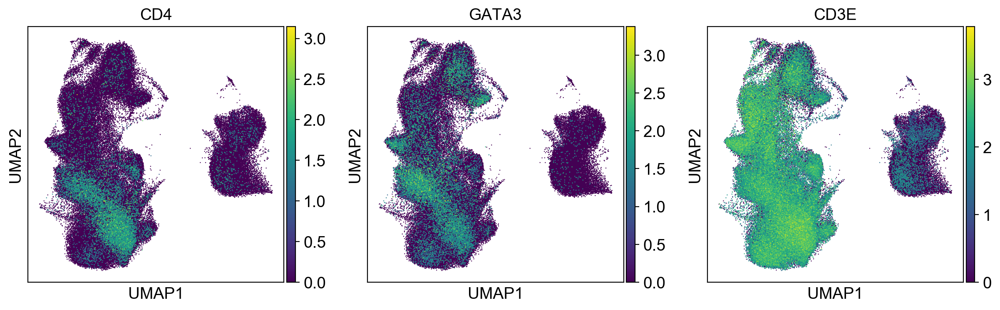

In [23]:


# sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['CD4',"GATA3","CD3E"], palette="Greys", size=3) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
# sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['CD4',"GATA3","CD3E"], palette="Greys", size=3) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)




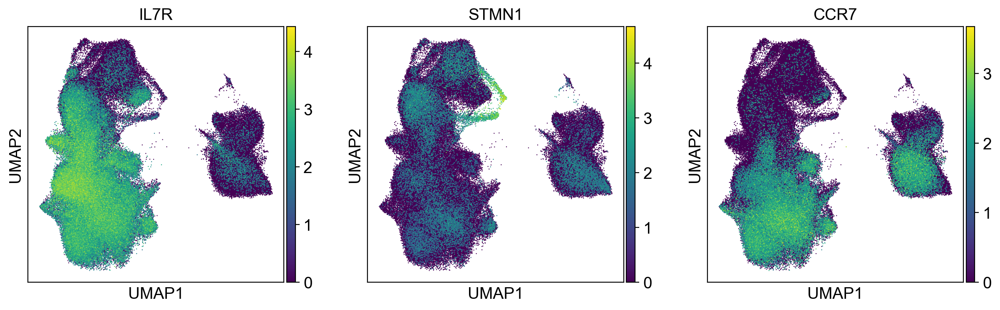

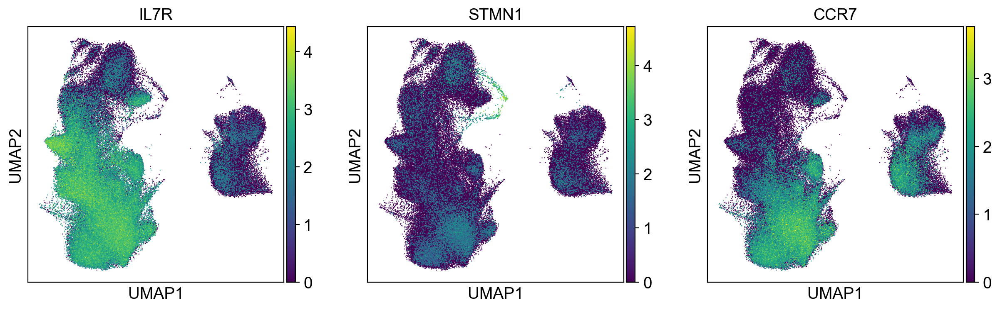

In [24]:

# sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['IL7R',"STMN1","CCR7"], palette="Greys", size=3) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
# sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['IL7R',"STMN1","CCR7"], palette="Greys", size=3) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)


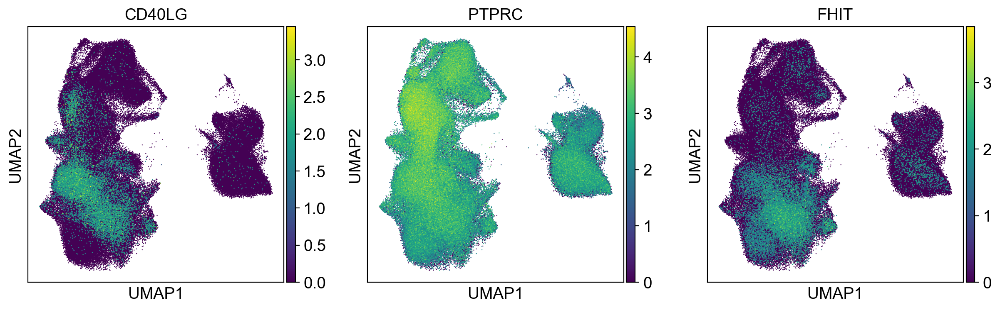

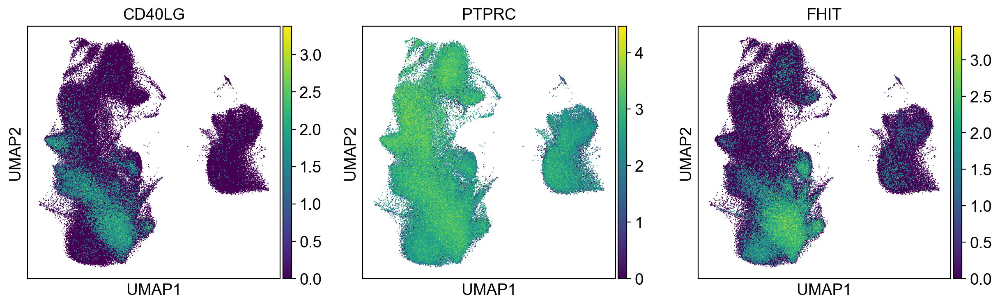

In [25]:

# sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['CD40LG',"PTPRC","FHIT"], palette="Greys", size=3) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
# sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['CD40LG',"PTPRC","FHIT"], palette="Greys", size=3) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)



# Figure 4C: Embedding and qualitative enrichment

In [26]:
sc.tl.embedding_density(adata, basis='umap', groupby='disease_pop_site_cov')

computing density on 'umap'


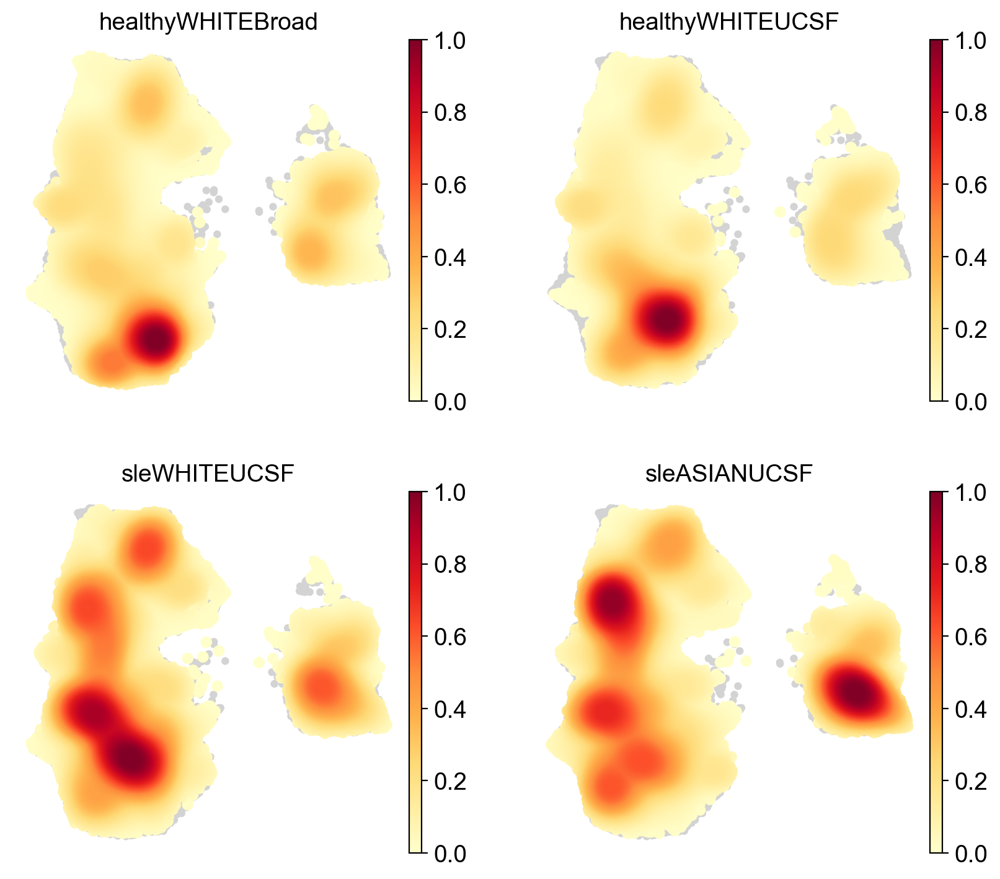

In [27]:
disease_umap = sc.pl.embedding_density(adata, basis="umap", key="umap_density_disease_pop_site_cov", frameon=False, ncols=2)
disease_umap = sc.pl.embedding_density(adata, basis="umap", key="umap_density_disease_pop_site_cov", frameon=False, ncols=2, save=".png")

# Figure 4D: Differences in subtype percentages for ALL samples

## Weighted least squares normalizing by total number of PBMCs

In [28]:
joined_pivot = pd.read_csv("CLUESImmVar_processed_joined_pivot_ct_perc."+version+".txt",index_col=False)

In [29]:
## Make proportion plots (Fig. 1D)

adata_obs_small = adata.obs;##[(adata.obs.batch_cov.str.contains("lupus"))]

##ind_count = adata_obs_small.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov','batch_cov'])['ct_cov'].count()

## no batch_cov so that we aggregate the count for the two healthy controls
ind_count = adata_obs_small.groupby(['ind_cov','ct_cov','disease_cov','pop_cov','batch_cov','site','disease_pop_site_cov'])['ct_cov'].count()

##ind_count = adata.obs.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()
##ind_count = adata.obs.groupby(['ind_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()

##ind_count = ind_count.reset_index(name="counts")
ind_count_sums = ind_count.groupby(["ind_cov","batch_cov"]).sum()
ind_count_sums = ind_count_sums.reset_index(name="counts")

##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
ind_count = ind_count.reset_index(name="ct_count")

## filter samples that have < 100 cells
ind_count = ind_count[ind_count.ind_cov.isin(ind_count_sums.ind_cov[ind_count_sums.counts > 100])]


ind_count.ind_cov = ind_count.ind_cov.apply(lambda x: x.split('_')[0])
ind_count_sums.ind_cov = ind_count_sums.ind_cov.apply(lambda x: x.split('_')[0])
ind_count.ind_cov = ind_count.ind_cov.astype("str")
ind_count.batch_cov = ind_count.batch_cov.astype("str")
ind_count.reset_index(inplace=True)
ind_count.ct_cov = ind_count.ct_cov.astype('category')
ind_count.ct_cov = ind_count.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)

ind_count = ind_count.join(joined_pivot.set_index(["ind_cov", 'disease_cov', 'batch_cov','disease_pop_site_cov']), on=["ind_cov", 'disease_cov', 'batch_cov','disease_pop_site_cov'])
ind_count = ind_count[~np.isnan(ind_count.pbmc_counts)]

ind_perc = ind_count;
ind_perc["ct_perc"] = ind_count.ct_count/ind_count.pbmc_counts*100


In [30]:
print("ind_count.shape: ",ind_count.shape)
print("ind_count_sums.shape: ", ind_count_sums.shape)
print("len(ind_count.ind_cov): ", len(ind_count.ind_cov))
print("len(ind_count.ind_cov.unique): ", len(ind_count.ind_cov.unique()))

## for now, let's filter out one of the reps for the healthies from UCSF only
## and filter out any broad samples that were replicated at UCSF
ind_perc_broad = ind_perc[~ind_perc.batch_cov.str.contains("lupus")]
ind_perc_ucsf = ind_perc[ind_perc.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ct_cov','ind_cov'])
ind_perc_all = ind_perc_ucsf.append(ind_perc_broad);

ind_count_broad = ind_count[~ind_count.batch_cov.str.contains("lupus")]
ind_count_ucsf = ind_count[ind_count.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ind_cov'])
ind_count_all = ind_count_ucsf.append(ind_count_broad);

ind_count_sums_broad = ind_count_sums[~ind_count_sums.batch_cov.str.contains("lupus")]
ind_count_sums_ucsf = ind_count_sums[ind_count_sums.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ind_cov'])
ind_count_sums_all = ind_count_sums_ucsf.append(ind_count_sums_broad);

ind_count.shape:  (3465, 77)
ind_count_sums.shape:  (2366, 3)
len(ind_count.ind_cov):  3465
len(ind_count.ind_cov.unique):  169


## Plot the figures

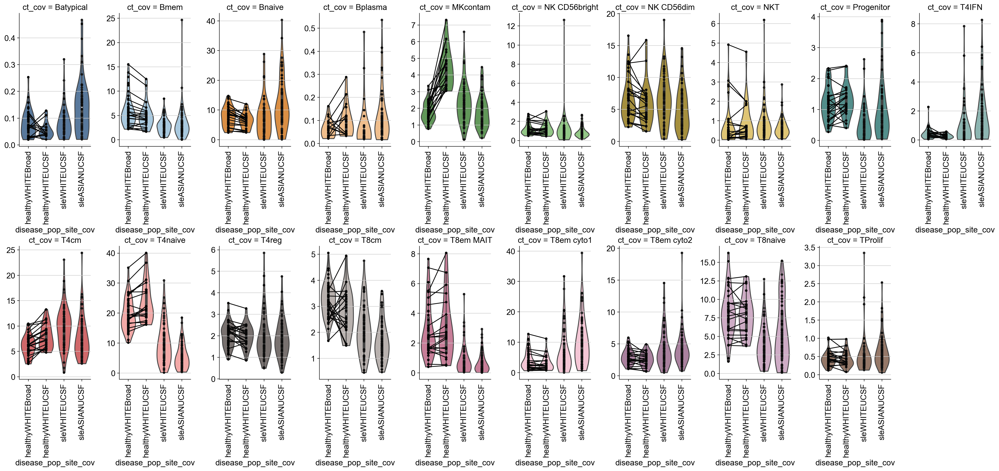

In [31]:
##plt.figure(figsize=(20,8))

ind_perc_all['site'] = pd.Categorical(ind_perc_all.disease_cov, categories=['Broad','UCSF'])
ind_perc_all.site[ind_perc_all.batch_cov.str.contains("immvar")] = "Broad"
ind_perc_all.site[~ind_perc_all.batch_cov.str.contains("immvar")] = "UCSF"

ind_perc_all['disease_pop_cov'] = pd.Categorical(ind_perc_all.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1),
                                             categories=['healthyWHITE','sleWHITE','sleASIAN'],
                                             ordered=True)

ind_perc_all['disease_pop_site_cov'] = pd.Categorical(ind_perc_all.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
                                             categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
                                             ordered=True)


plot=sb.catplot(x='disease_pop_site_cov', y='ct_perc', hue='ct_cov', data=ind_perc_all, kind='violin', col='ct_cov', 
                dodge=False, aspect=0.5, height=5, sharex=False, sharey=False, cut=0, col_wrap=10,
               palette = ["#4E79A7","#A0CBE8","#F28E2B","#FFBE7D","#59A14F","#8CD17D","#B6992D","#F1CE63","#499894","#86BCB6","#E15759","#FF9D9A","#79706E","#BAB0AC","#D37295","#FABFD2","#B07AA1","#D4A6C8","#9D7660","#D7B5A6"]) #, palette=sc.pl.palettes.vega_20_scanpy
plot.set_xticklabels(rotation=90)
plot.fig.subplots_adjust(wspace=0.4, hspace=0.75)

for ct_i in list(range(len(ind_perc_all.ct_cov.cat.categories))) :
    ct = ind_perc_all.ct_cov.cat.categories[ct_i]
    
    sb.pointplot(x="disease_pop_site_cov", y="ct_perc", hue = "ind_cov", data=ind_perc_all[ind_perc_all.ct_cov == ct], color="0", scale=0.5,
                 ax=plot.axes[ct_i], legend=False)
    
    plot.axes[ct_i].get_yaxis().label.set_visible(False)
    plot.axes[ct_i].get_legend().remove()
    
    plot.axes[ct_i].get_yaxis().label.set_visible(False)

plot.savefig(figdir+"/violin_lymphoid.png")


## Compute statistics

In [32]:
ind_count = ind_count_all.drop_duplicates(subset=['ct_cov','ind_cov']);
ind_count_sums = ind_count_sums_all.drop_duplicates(subset=['ind_cov']);
ind_perc = ind_perc.drop_duplicates(subset=['ct_cov','ind_cov']);

In [33]:
print('\nall sle vs all healthy')

all_out = pd.DataFrame()

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    
    weights = ind_perc[ind_perc.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
    
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    ##r2=est.rsquared
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    all_out = all_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(all_out);

print('\nwhite sle vs white healthy')

white_out = pd.DataFrame();

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ind_perc_small = ind_perc[ind_perc.pop_cov=="WHITE"];
    
    ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
    disease = ind_perc_small.disease_cov[ind_perc_small.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    
    weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)

    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    white_out = white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(white_out); ##print(white_out)

asian_sle_white_out = pd.DataFrame();
    
print('\nasian sle vs white healthy')

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ind_perc_small = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))]
   
    ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
    disease = ind_perc_small.disease_cov[ind_perc_small.ct_cov==ct]
    
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    
    weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
    
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    asian_sle_white_out = asian_sle_white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(asian_sle_white_out); ##print(white_out) 
  
print('\nwhite sle vs asian sle')

asian_white_sle_out = pd.DataFrame();

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ind_perc_small = ind_perc[ind_perc.disease_cov=="sle"];
    
    ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
    pop = ind_perc_small.pop_cov[ind_perc_small.ct_cov==ct]
    
    pop = pop.astype("str")
    pop.values[pop=="ASIAN"] = 0
    pop.values[pop=="WHITE"] = 1
    pop = sm.add_constant(pop)
   
    ##data = data.assign(ct_perc=ct_perc)
    weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), pop.astype(float), weights=weights)
    
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    asian_white_sle_out = asian_white_sle_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(asian_white_sle_out); ##print(white_out)  


all sle vs all healthy


/Users/yimmieg/opt/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2495: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


,Beta,Cell,LogFC,Pval
0,-0.04285573549095187,Batypical,-0.6358190013713237,0.008701532961307231
1,2.7265925869174525,Bmem,0.9260874221944239,1.9598840156949566e-07
2,-2.1486639219105355,Bnaive,-0.36213153583353885,0.0883046988792446
3,-0.03165327034443906,Bplasma,-0.5794826539383741,0.15172346086731242
4,-0.10946275192180864,MKcontam,-0.07988858829011716,0.5555437006729937
5,0.19813062005853838,NK CD56bright,0.27068264275553616,0.2314522933787034
6,0.6301619464400948,NK CD56dim,0.15105621995364227,0.30832954247500494
7,-0.0528746643253232,NKT,-0.10699102329030692,0.7114041396364901
8,0.39235001440173456,Progenitor,0.5889345378422507,0.0030490183323070657
9,-0.8974384449206851,T4IFN,-1.6644252996844908,0.0005337910858013491



white sle vs white healthy


,Beta,Cell,LogFC,Pval
0,-0.006857179779985642,Batypical,-0.12249318502080946,0.5714249387981576
1,2.995588863064094,Bmem,1.0602514888422836,2.778959864775376e-09
2,0.2715394511726785,Bnaive,0.05298179975941703,0.7937406512592988
3,-0.0051580503931059046,Bplasma,-0.1117667577270515,0.8012015153907788
4,-0.4393609841458437,MKcontam,-0.29693434291512794,0.04079532527703605
5,0.07807913888708243,NK CD56bright,0.10069473572361179,0.7238378140027533
6,-0.05140012043177622,NK CD56dim,-0.011650857838150312,0.9397243956827463
7,-0.17417370318159595,NKT,-0.3260514056532381,0.36128890577470874
8,0.6067235416191654,Progenitor,1.053779887659078,1.7328723738910343e-07
9,-0.557052141564238,T4IFN,-1.2307377924092588,0.015919184816821624



asian sle vs white healthy


,Beta,Cell,LogFC,Pval
0,-0.06954959654749876,Batypical,-0.9250736589506087,0.00023415274677261174
1,2.507061119188217,Bmem,0.8251463803489079,0.000150772680296385
2,-4.156108810953644,Bnaive,-0.6340303951960072,0.003092030651148518
3,-0.044769446296764735,Bplasma,-0.764806475205659,0.04712898267125067
4,0.16889475594514616,MKcontam,0.1326564164794548,0.34312465748657406
5,0.30067422363273677,NK CD56bright,0.4336474319234805,0.005254973446588538
6,1.205242076794557,NK CD56dim,0.30423593476062977,0.06714901468310731
7,0.04947355965594201,NKT,0.10784688511249617,0.7274833778512424
8,0.20593125383707658,Progenitor,0.27913922458670193,0.18285268396078463
9,-1.1738621320264833,T4IFN,-1.9404393632750179,2.373851509177646e-05



white sle vs asian sle


,Beta,Cell,LogFC,Pval
0,-0.06269241676751315,Batypical,-0.8025804739297988,0.0006284628591562775
1,-0.4885277438758743,Bmem,-0.23510510849337582,0.3471200058113386
2,-4.427648262126322,Bnaive,-0.6870121949554238,0.0025880878108183714
3,-0.0396113959036588,Bplasma,-0.6530397174786072,0.09577064272469699
4,0.6082557400909898,MKcontam,0.4295907593945831,0.0024435328911594297
5,0.22259508474565434,NK CD56bright,0.332952696199869,0.2481666292040877
6,1.2566421972263335,NK CD56dim,0.3158867925987804,0.05920752977763016
7,0.22364726283753805,NKT,0.43389829076573433,0.09744173155691162
8,-0.4007922877820889,Progenitor,-0.7746406630723763,0.007642159187130464
9,-0.6168099904622453,T4IFN,-0.7097015708657572,0.04606751054597705


# Figure 4E: Correlation of composition with IFN score

## Read in interferon score calculation and join

In [34]:
ifn = pd.read_table("../meta/ifn_sig.V2.txt", sep=" ", index_col=False)
ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
joined2 = ifn.join(ind_perc.set_index("ind_cov"), on="name")

joined2["disease_pop_site_cov"] = joined2["disease_pop_site_cov"].astype(str)
joined2["ct_cov"] = joined2["ct_cov"].astype(str)

In [35]:
joined_pivot2_percs = joined2.pivot_table(index=['name',"disease_pop_site_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="ct_perc")
joined_pivot2_percs.reset_index(inplace=True)

##print(joined_pivot2_percs[joined_pivot2_percs.pbmc < 0])
joined_pivot2_percs = joined_pivot2_percs[joined_pivot2_percs.pbmc > 0]

##print(joined_pivot2_percs[joined_pivot2_percs.pbmc > 10])
joined_pivot2_percs = joined_pivot2_percs[joined_pivot2_percs.pbmc < 10]


all_ifn_out = pd.DataFrame();

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = joined_pivot2_percs[ct]
    ifn = joined_pivot2_percs.ifn
    ifn = sm.add_constant(ifn)
    est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor=joined_pivot2_percs.ifn.corr(joined_pivot2_percs[ct])
    
    all_ifn_out = all_ifn_out.append({'Cluster': str(ct), 'Beta': str(effect), 'R2': str(r2), 'pvalue': str(pval), 'cor': str(cor)}, ignore_index=True)
display(all_ifn_out)

  
sle_ifn_out = pd.DataFrame();

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ##ct_perc = joined_pivot2_percs[ct]
    ifn = joined_pivot2_percs.ifn
    ifn = sm.add_constant(ifn)
    
    sle_only = joined_pivot2_percs[joined_pivot2_percs.disease_pop_site_cov.str.contains("sle")]
    
    ##print('Cluster type:'+ ct)
    est=sm.OLS(sle_only[ct].astype(float), sm.add_constant(sle_only.ifn).astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor=sle_only.ifn.corr(sle_only[ct])
    sle_ifn_out = sle_ifn_out.append({'Cluster': str(ct), 'Beta': str(effect), 'R2': str(r2), 'pvalue': str(pval), 'cor': str(cor)}, ignore_index=True)
display(sle_ifn_out)


as a proportion of cell type


,Beta,Cluster,R2,cor,pvalue
0,0.004433565466023519,Batypical,0.07046636216202273,0.26545500967588226,0.004673291435405703
1,-0.10466416920924015,Bmem,0.06724805265447575,-0.2593222949429445,0.0034967952998660196
2,0.22149736421916305,Bnaive,0.023129478394842473,0.15208378741615658,0.08912594462380603
3,0.005330418495910623,Bplasma,0.07236961872540748,0.26901601945870746,0.009121544461591037
4,-0.11193709511171356,MKcontam,0.2887755236077316,-0.5373783802943057,7.323190628650422e-11
5,0.0008870104279222156,NK CD56bright,1.5624151937787545e-05,0.003952739801450837,0.9649622998173291
6,-0.16618267592854702,NK CD56dim,0.05757972014979151,-0.23995774659258545,0.0065823208377284725
7,-0.03356270134968687,NKT,0.041422020451155395,-0.20352400460671766,0.02173330716105992
8,0.018113074351984063,Progenitor,0.015111271862032982,0.12292791327454106,0.1791839868142306
9,0.19809213990920171,T4IFN,0.41606761880203924,0.6450330369849587,4.710551185904068e-16


as a proportion of cell type


,Beta,Cluster,R2,cor,pvalue
0,0.004155069107131992,Batypical,0.05425399629024363,0.23292487263116302,0.019074716608977204
1,-0.05929348104578191,Bmem,0.027503025736410724,-0.16584036220537723,0.07917662024506616
2,0.23985487011374973,Bnaive,0.023055600618330452,0.15184070804079636,0.10680666633273955
3,0.006437506089752349,Bplasma,0.08669278401735392,0.294436383650788,0.006554581464679727
4,-0.11595633762412311,MKcontam,0.28792672397118724,-0.5365880393478664,6.36139010664406e-10
5,0.012070463502414768,NK CD56bright,0.0025263840901775803,0.05026314843080886,0.5953598244269231
6,-0.16459861961279837,NK CD56dim,0.05238524146653856,-0.22887822409862105,0.013878806829911845
7,-0.03295073807135674,NKT,0.04822192326331742,-0.21959490718893604,0.018372398036438843
8,0.028946242160833743,Progenitor,0.033174656086541576,0.18213911190774384,0.05801915358644774
9,0.2118893888972838,T4IFN,0.40903111487522836,0.6395554040700686,2.4483284370469322e-14


## Plot the figures

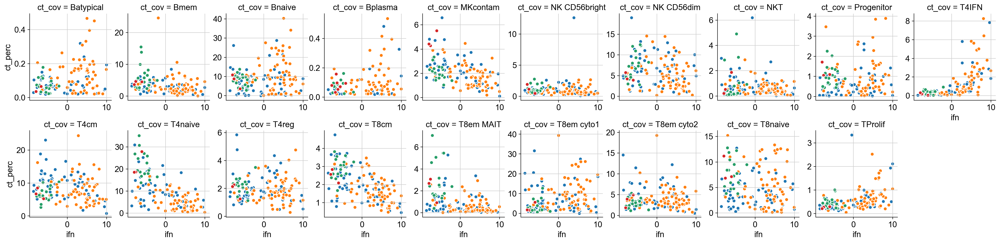

In [36]:
joined2['ct_cov'] = joined2['ct_cov'].astype('category')
g = sb.FacetGrid(joined2, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap= 10)
g = g.map(plt.scatter, "ifn", "ct_perc", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/ifn_ct_cov.png")

# Figure 4G: TCR Analysis

## Read in the TCR analysis from Tony's pipeline

In [37]:
th_tcr = pd.read_csv("../tcr/Th_sharedclones_hiseq_CDR3.csv", index_col=False)
tc_tcr = pd.read_csv("../tcr/Tc_sharedclones_hiseq_CDR3.csv", index_col=False)
all_tcr = pd.read_csv("../tcr/TCR_paired_final_hiseq.csv", index_col=False)

In [38]:
adata.obs["tcr"] = 0
cell_index_match = (adata.obs.index.str.slice(0, 16)).isin(all_tcr["cell-barcode"]);
ind_cov_match = (adata.obs.ind_cov).isin(all_tcr["ind_cov"])
adata.obs.loc[(cell_index_match & ind_cov_match), "tcr"] = 1

In [39]:
print("Number of CD4 TCRs: ", all_tcr[all_tcr.ct_cov=="Th"].shape)
print("Number of CD8 TCRs: ", all_tcr[all_tcr.ct_cov=="Tc"].shape)
print("Number of CD4 cells: ", sum(adata.obs.ct_cov.str.contains("T4")))
print("Number of CD8 TCRs: ", sum(adata.obs.ct_cov.str.contains("T8")))
print("Proportion of CD4s with TCRs: ", sum(all_tcr[all_tcr.ct_cov=="Th"].shape)/sum(adata.obs.ct_cov.str.contains("T4")))
print("Proportion of CD8s with TCRs: ", sum(all_tcr[all_tcr.ct_cov=="Tc"].shape)/sum(adata.obs.ct_cov.str.contains("T8")))

Number of CD4 TCRs:  (11855, 16)
Number of CD8 TCRs:  (8721, 16)
Number of CD4 cells:  179861
Number of CD8 TCRs:  158245
Proportion of CD4s with TCRs:  0.06600096741372505
Proportion of CD8s with TCRs:  0.055211855034914215


## Find the MAIT and NKT cells

In [40]:
all_tcr_mait = all_tcr.loc[(all_tcr.alphaJGene=="TRAJ33") & (all_tcr.alphaVGene=="TRAV1-2")]

In [41]:
all_tcr_nkt = all_tcr.loc[(all_tcr.alphaVGene=="TRAV24")]

In [42]:
adata.obs["nkt"] = 0
cell_index_match = (adata.obs.index.str.slice(0, 16)).isin(all_tcr_nkt["cell-barcode"]);
ind_cov_match = (adata.obs.ind_cov).isin(all_tcr_nkt["ind_cov"])
adata.obs.loc[(cell_index_match & ind_cov_match), "mait"] = 1

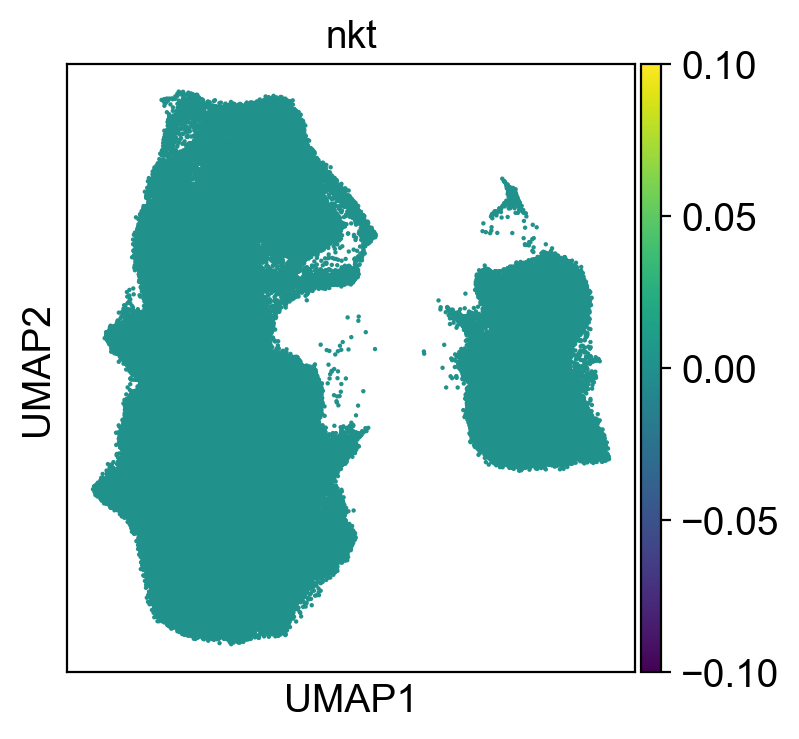

In [43]:
sc.pl.umap(adata, color='nkt', size = 10)
sc.pl.umap(adata, color='nkt', size=10, edgecolor="none", save="_tcr_nkt.png")

In [44]:
adata.obs["mait"] = 0
cell_index_match = (adata.obs.index.str.slice(0, 16)).isin(all_tcr_mait["cell-barcode"]);
ind_cov_match = (adata.obs.ind_cov).isin(all_tcr_mait["ind_cov"])
adata.obs.loc[(cell_index_match & ind_cov_match), "mait"] = 1
adata.obs["mait"] = adata.obs["mait"].astype("category")

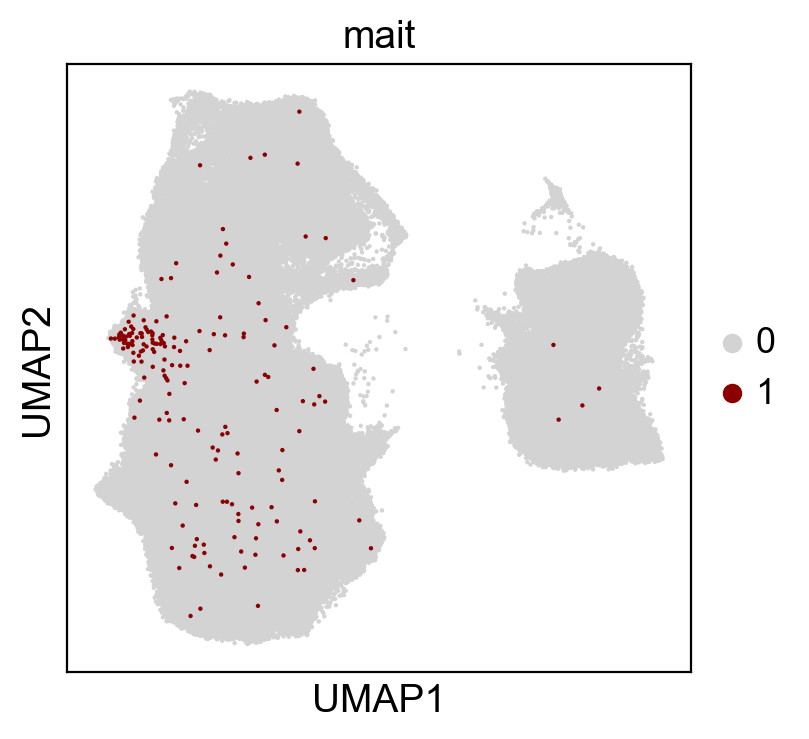

In [45]:
sc.pl.umap(adata[adata.obs.mait.argsort()], color='mait', size = 10, palette=["lightgray","darkred"])
sc.pl.umap(adata[adata.obs.mait.argsort()], color='mait', size=10, edgecolor="none", save="_tcr_mait.png", palette=["lightgray","darkred"])

## Find expanded TCRs

In [46]:
all_tcr_tc_expanded_matched = all_tcr.loc[(all_tcr.alphaCDR3+"."+all_tcr.betaCDR3).isin(tc_tcr.TCR[tc_tcr['total.cells'] > 2])]
all_tcr_th_expanded_matched = all_tcr.loc[(all_tcr.alphaCDR3+"."+all_tcr.betaCDR3).isin(th_tcr.TCR[th_tcr['total.cells'] > 2])]
all_tcr_matched = all_tcr.loc[(all_tcr.alphaCDR3+"."+all_tcr.betaCDR3).isin(tc_tcr.TCR[tc_tcr['total.cells'] > 0])]

In [47]:
all_tcr_tc_alpha_expanded_matched = all_tcr.loc[all_tcr.alphaCDR3.isin(tc_tcr.TCR[tc_tcr['total.cells'] > 2])]
all_tcr_th_alpha_expanded_matched = all_tcr.loc[all_tcr.alphaCDR3.isin(th_tcr.TCR[th_tcr['total.cells'] > 2])]

all_tcr_tc_beta_expanded_matched = all_tcr.loc[all_tcr.betaCDR3.isin(tc_tcr.TCR[tc_tcr['total.cells'] > 2])]
all_tcr_th_beta_expanded_matched = all_tcr.loc[all_tcr.betaCDR3.isin(th_tcr.TCR[th_tcr['total.cells'] > 2])]

In [48]:
adata.obs["tc_expanded"] = 0
cell_index_match = (adata.obs.index.str.slice(0, 16)).isin(all_tcr_tc_expanded_matched["cell-barcode"]);
ind_cov_match = (adata.obs.ind_cov).isin(all_tcr_tc_expanded_matched["ind_cov"])
adata.obs.loc[(cell_index_match & ind_cov_match), "tc_expanded"] = 1
adata.obs["tc_expanded"] = adata.obs["tc_expanded"].astype("category")

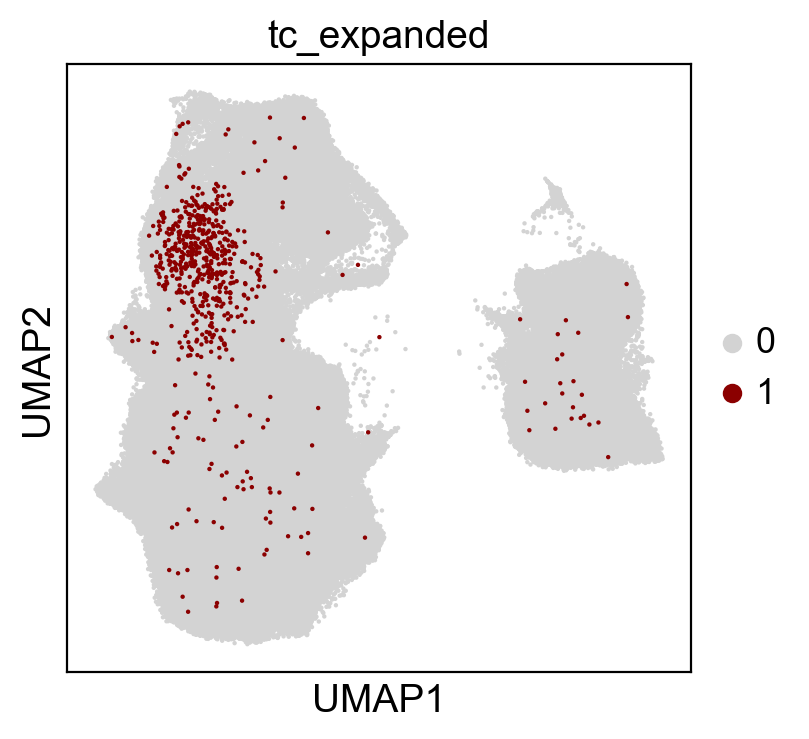

In [49]:
sc.pl.umap(adata[adata.obs.tc_expanded.argsort()], color='tc_expanded', size = 10, palette=["lightgray","darkred"])
sc.pl.umap(adata[adata.obs.tc_expanded.argsort()], color='tc_expanded', size=10, edgecolor="none", save="_tcr_tc_expansion.png", palette=["lightgray","darkred"])

In [50]:
adata.obs["th_expanded"] = 0
cell_index_match = (adata.obs.index.str.slice(0, 16)).isin(all_tcr_th_expanded_matched["cell-barcode"]);
ind_cov_match = (adata.obs.ind_cov).isin(all_tcr_th_expanded_matched["ind_cov"])
adata.obs.loc[(cell_index_match & ind_cov_match), "th_expanded"] = 1
adata.obs["th_expanded"] = adata.obs["th_expanded"].astype("category")

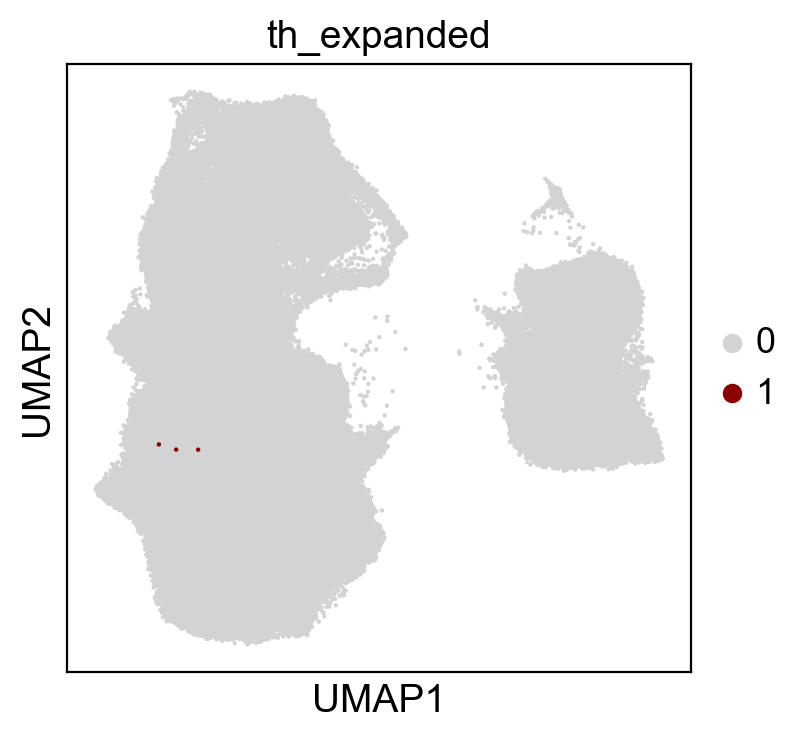

In [51]:
sc.pl.umap(adata[adata.obs.th_expanded.argsort()], color='th_expanded', size = 10, palette=["lightgray","darkred"])
sc.pl.umap(adata[adata.obs.th_expanded.argsort()], color='th_expanded', size=10, edgecolor="none", save="_tcr_th_expansion.png", palette=["lightgray","darkred"])

In [56]:
obs_healthy_broad = adata.obs[adata.obs.batch_cov.str.contains("immvar") & (adata.obs.disease_cov=="healthy")]
obs_healthy_ucsf = adata.obs[~adata.obs.batch_cov.str.contains("immvar") & (adata.obs.disease_cov=="healthy")]
obs_sle = adata.obs[(adata.obs.disease_cov=="sle")]

obs_lupus_batch = adata.obs[adata.obs.batch_cov.str.contains("lupus")]
obs_immvar_batch = adata.obs[adata.obs.batch_cov.str.contains("immvar")]


In [58]:
print("healthy broad: ", sum(obs_healthy_broad.tcr==1)/obs_healthy_broad.shape[0])
print("healthy ucsf: ", sum(obs_healthy_ucsf.tcr==1)/obs_healthy_ucsf.shape[0])
print("sle: ", sum(obs_sle.tcr==1)/obs_sle.shape[0])

healthy broad:  0.0118712402406246
healthy ucsf:  0.08332922257300711
sle:  0.0738559343307561


In [62]:
print("healthy broad: ", sum((obs_healthy_broad.tcr==1) & (obs_healthy_broad.ct_cov == "T8em cyto1"))/sum(obs_healthy_broad.ct_cov=="T8em cyto1"))
print("healthy ucsf: ", sum((obs_healthy_ucsf.tcr==1) & (obs_healthy_ucsf.ct_cov =="T8em cyto1"))/sum(obs_healthy_ucsf.ct_cov == "T8em cyto1"))
print("sle: ", sum((obs_sle.tcr==1) & (obs_sle.ct_cov=="T8em cyto1"))/sum(obs_sle.ct_cov=="T8em cyto1"))

healthy broad:  0.007869667264945465
healthy ucsf:  0.07142857142857142
sle:  0.07923380281690141


In [63]:
print("healthy broad T4: ", sum((obs_healthy_broad.tcr==1) & obs_healthy_broad.ct_cov.str.contains("T4"))/sum(obs_healthy_broad.ct_cov.str.contains("T4")))
print("healthy broad T8: ", sum((obs_healthy_broad.tcr==1) & obs_healthy_broad.ct_cov.str.contains("T8"))/sum(obs_healthy_broad.ct_cov.str.contains("T8")))

print("healthy ucsf T4: ", sum((obs_healthy_ucsf.tcr==1) & obs_healthy_ucsf.ct_cov.str.contains("T4"))/sum(obs_healthy_ucsf.ct_cov.str.contains("T4")))
print("healthy ucsf T8: ", sum((obs_healthy_ucsf.tcr==1) & obs_healthy_ucsf.ct_cov.str.contains("T8"))/sum(obs_healthy_ucsf.ct_cov.str.contains("T8")))

print("sle T4: ", sum((obs_sle.tcr==1) & obs_sle.ct_cov.str.contains("T4"))/sum(obs_sle.ct_cov.str.contains("T4")))
print("sle T8: ", sum((obs_sle.tcr==1) & obs_sle.ct_cov.str.contains("T8"))/sum(obs_sle.ct_cov.str.contains("T8")))

# print("healthy ucsf: ", sum(obs_healthy_ucsf.tcr==1)/obs_healthy_ucsf.shape[0])
# print("sle: ", sum(obs_sle.tcr==1)/obs_sle.shape[0])

healthy broad T4:  0.013492642326998155
healthy broad T8:  0.00947527888720562
healthy ucsf T4:  0.1025539160045403
healthy ucsf T8:  0.08815716934796772
sle T4:  0.10226217564768425
sle T8:  0.0866875189975193


In [65]:
print("lupus batch T4: ", sum((obs_lupus_batch.tcr==1) & obs_lupus_batch.ct_cov.str.contains("T4"))/sum(obs_lupus_batch.ct_cov.str.contains("T4")))
print("lupus batch T8: ", sum((obs_lupus_batch.tcr==1) & obs_lupus_batch.ct_cov.str.contains("T8"))/sum(obs_lupus_batch.ct_cov.str.contains("T8")))

print("immvar batch T4: ", sum((obs_immvar_batch.tcr==1) & obs_immvar_batch.ct_cov.str.contains("T4"))/sum(obs_immvar_batch.ct_cov.str.contains("T4")))
print("immvar batch T8: ", sum((obs_immvar_batch.tcr==1) & obs_immvar_batch.ct_cov.str.contains("T8"))/sum(obs_immvar_batch.ct_cov.str.contains("T8")))

# print("healthy ucsf: ", sum(obs_healthy_ucsf.tcr==1)/obs_healthy_ucsf.shape[0])
# print("sle: ", sum(obs_sle.tcr==1)/obs_sle.shape[0])

lupus batch T4:  0.10233933489939434
lupus batch T8:  0.08692799737575857
immvar batch T4:  0.013492642326998155
immvar batch T8:  0.00947527888720562


# 6. Let's recompute the IFN score

In [72]:
diffexp_annot = pd.read_table("../figure2_prop_var/diffexp_annotations.txt", sep="\t", index_col=False)
diffexp_annot.cluster = diffexp_annot.cluster.astype("category")

In [73]:
for cluster_i in diffexp_annot.cluster.cat.categories:
    print(cluster_i)
    cluster_X = adata.X[:,adata.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster==cluster_i])];
    adata.obs[cluster_i] = np.sum(cluster_X, axis=1)
    

B
Lymph
Mono
Pan
T4
T8
ncM
pDC


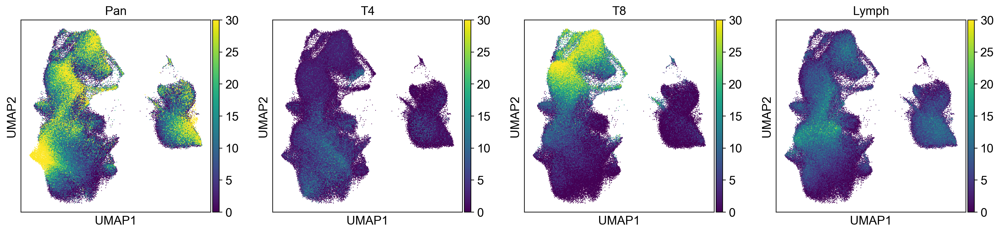

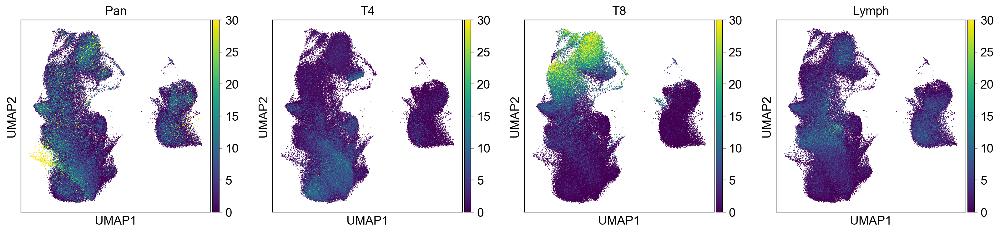

In [75]:
##fig,ax = plt.subplots(nrows=1,ncols=2, figsize=(10,5),sharex=True, sharey=True)
##fig.tight_layout()

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['Pan',"T4","T8", "Lymph"], palette="Greys", size=3,vmin=0, vmax=30)
sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['Pan',"T4","T8", "Lymph"], palette="Greys", size=3, vmin=0, vmax=30)



##sc.pl.umap(adata[adata.obs.disease_cov=="healthy",], color = "all_ifn", ax=ax[1])                                                      